In [1]:
import numpy as np
import matplotlib.pyplot as plt

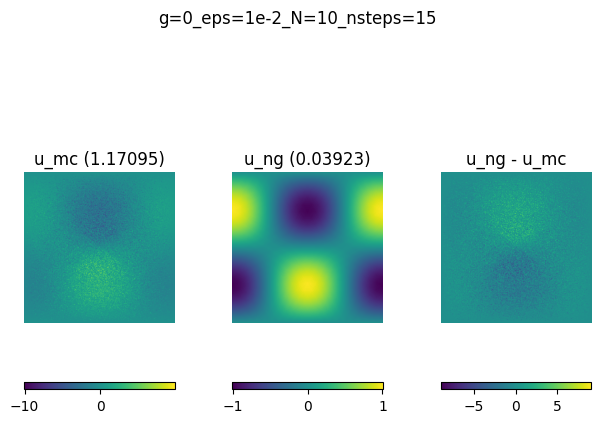

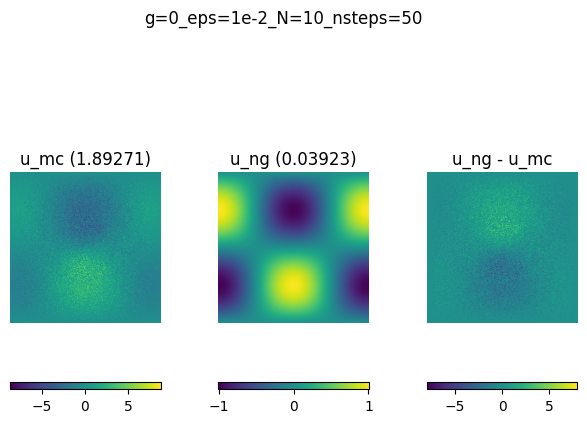

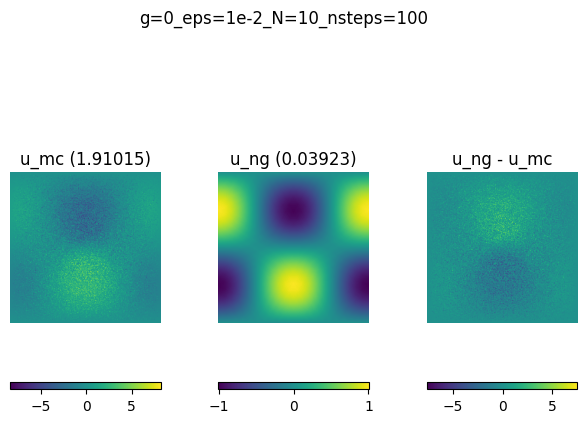

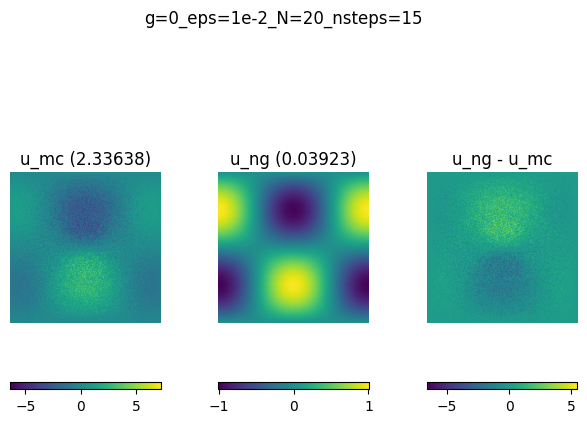

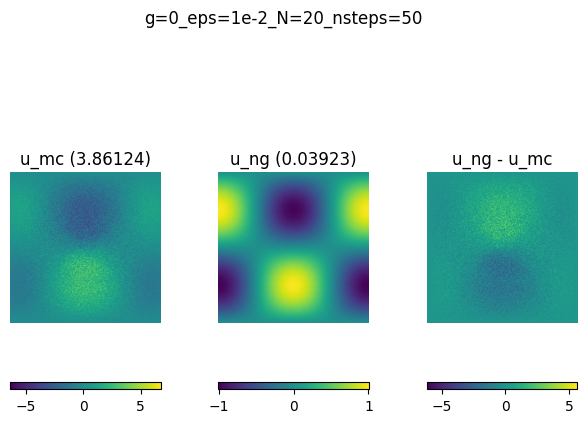

...

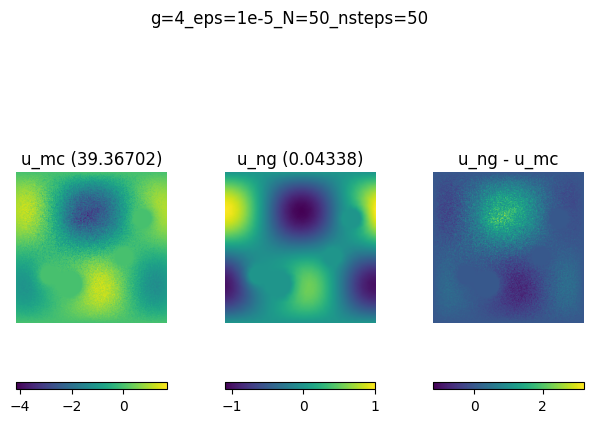

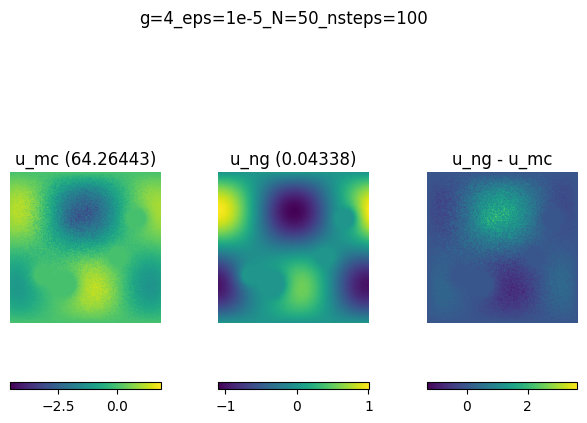

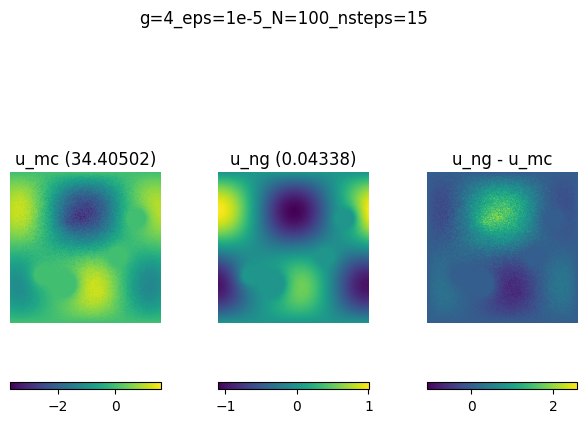

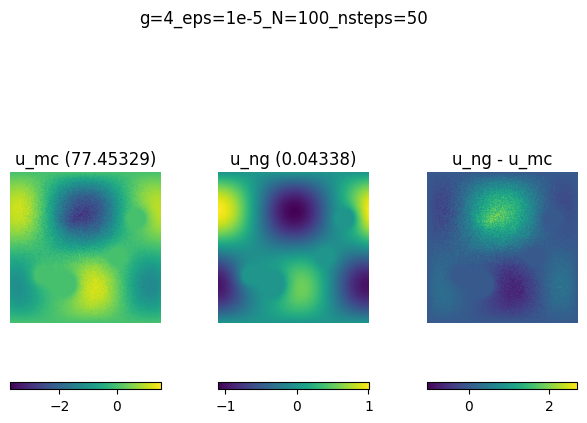

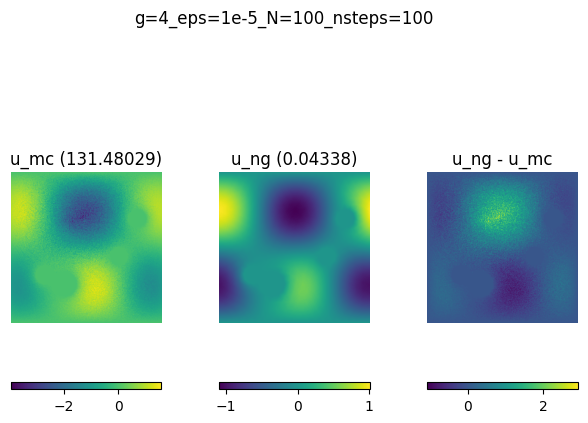

In [7]:
bnd_tol = ['1e-2', '1e-3', '1e-4', '1e-5']
nwalkers = [10, 20, 50, 100]
nsteps = [15, 50, 100]

n_geom = 5

errors_infty = np.zeros(shape=(n_geom, len(bnd_tol), len(nwalkers), len(nsteps)))
errors_L2 = np.zeros(shape=(n_geom, len(bnd_tol), len(nwalkers), len(nsteps)))

for i in range(n_geom):
    fem = np.load(f'results/ng_{i}.npy', allow_pickle=True).item()
    for j, eps in enumerate(bnd_tol):
        for k, N in enumerate(nwalkers):
            for l, s in enumerate(nsteps):
                mc = np.load(f'results/mc_{i}_{eps}_{N}_{s}.npy', allow_pickle=True).item()
                
                fig, ax = plt.subplots(ncols=3)
                fig.tight_layout()
                p = ax[0].imshow(mc['u'])
                ax[0].axis('off')
                ax[0].title.set_text(f'u_mc ({mc['t']:.5f})')
                fig.colorbar(p, ax=ax[0], location='bottom')
                
                p = ax[1].imshow(fem['u'])
                ax[1].axis('off')
                ax[1].title.set_text(f'u_ng ({fem['t']:.5f})')
                fig.colorbar(p, ax=ax[1], location='bottom')
                
                p = ax[2].imshow(fem['u'] - mc['u'])
                ax[2].axis('off')
                ax[2].title.set_text('u_ng - u_mc')
                fig.colorbar(p, ax=ax[2], location='bottom')
    
                errors_infty[i, j, k, l] = np.max(np.abs(mc['u'] - fem['u'])) / np.max(np.abs(fem['u']))

                plt.subplots_adjust(top=0.9)
                fig.suptitle(f'g={i}_eps={eps}_N={N}_nsteps={s}')
                plt.show()

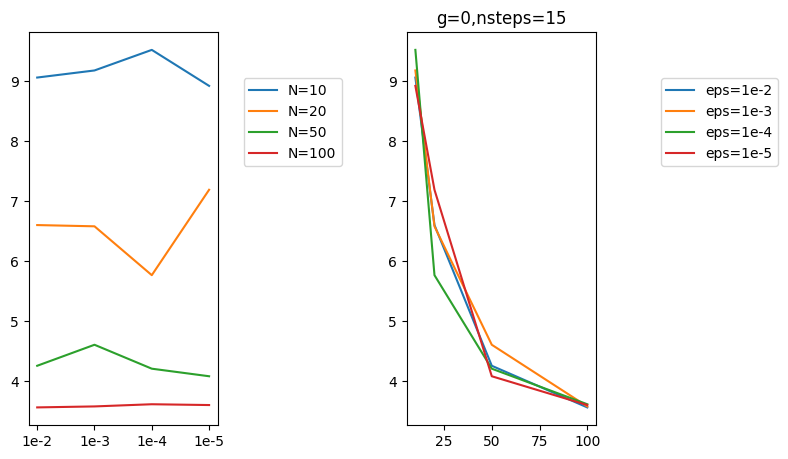

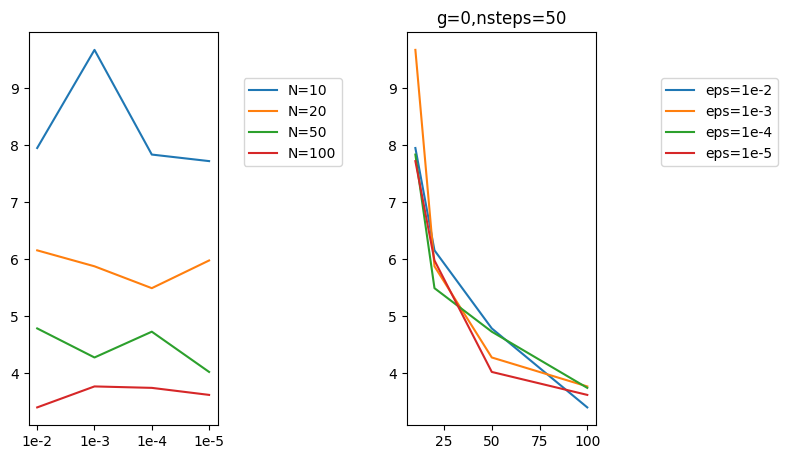

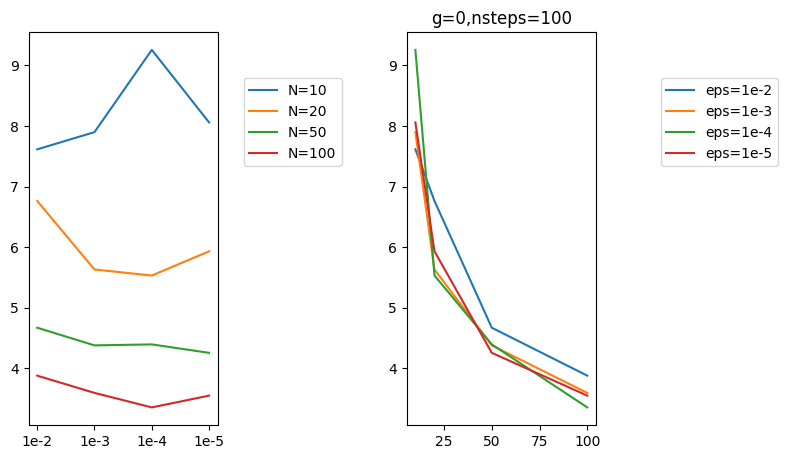

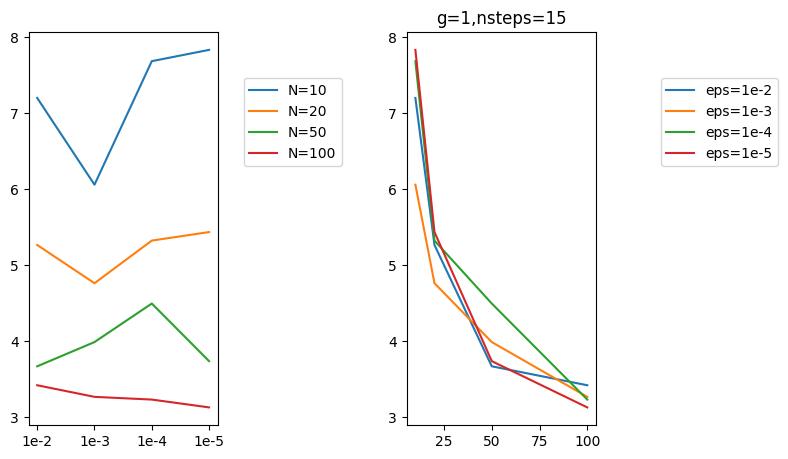

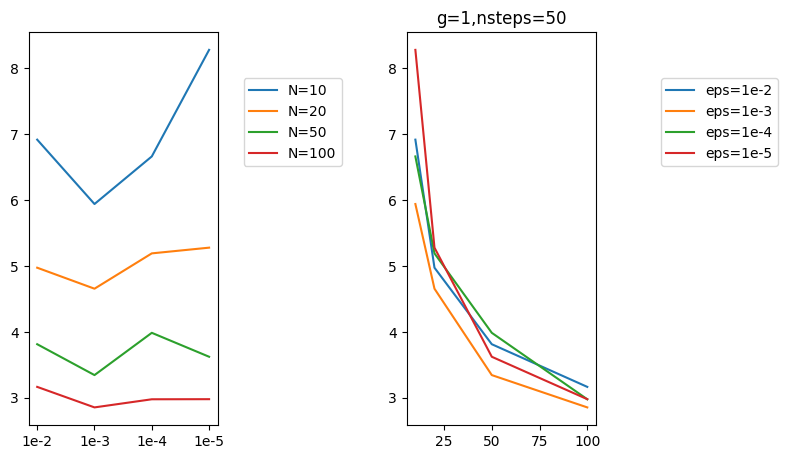

...

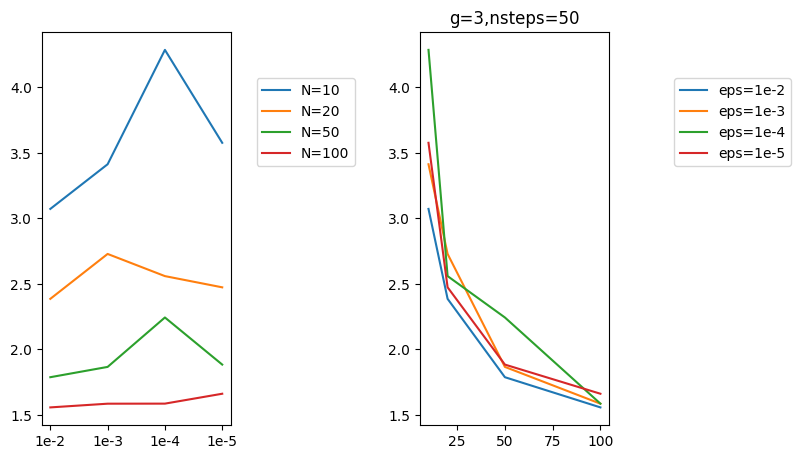

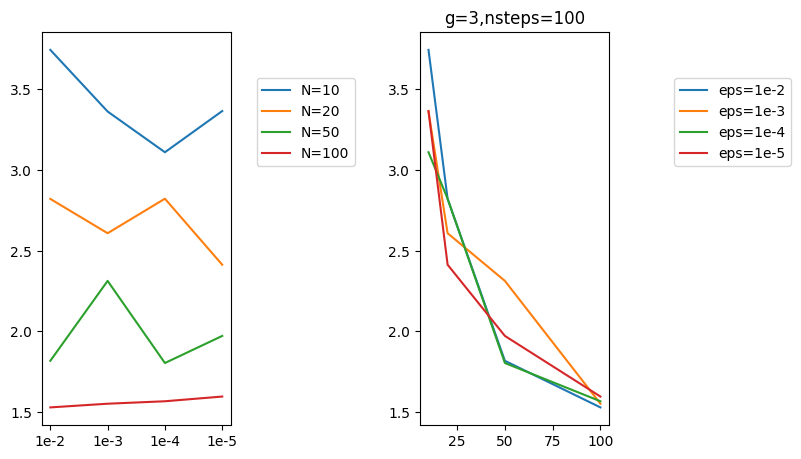

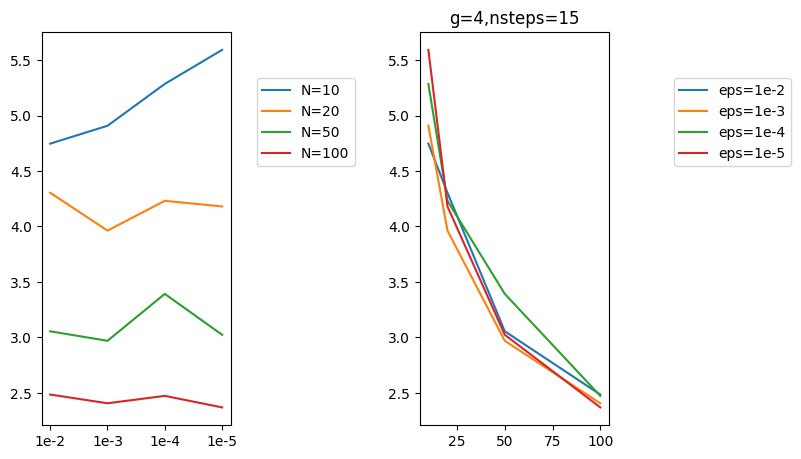

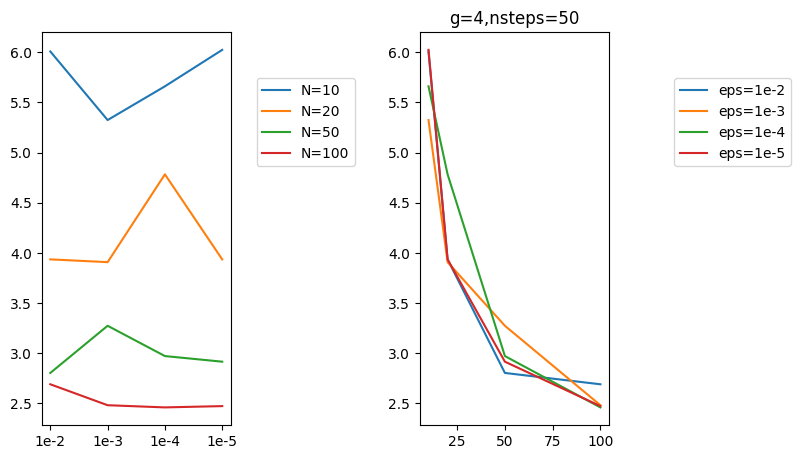

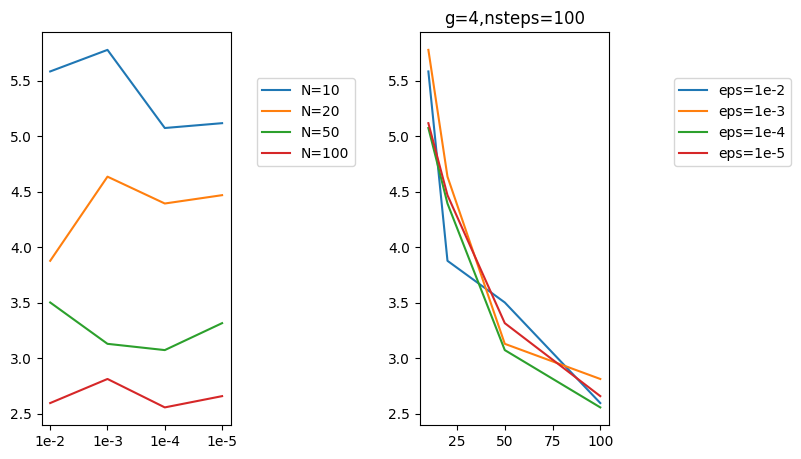

In [5]:
for i in range(n_geom):
    for l in range(len(nsteps)):
        fig, ax = plt.subplots(ncols=2)
        fig.tight_layout()
    
        for n in range(len(nwalkers)):
            ax[0].plot(bnd_tol, errors_infty[i, :, n, l], label=f'N={nwalkers[n]}')
        ax[0].legend(bbox_to_anchor=(1.1, .9))
        
        for b in range(len(bnd_tol)):
            ax[1].plot(nwalkers, errors_infty[i, b, :, l], label=f'eps={bnd_tol[b]}')
        ax[1].legend(bbox_to_anchor=(2.0, .9))
    
        plt.subplots_adjust(wspace=1.0, top=0.9)
        plt.title(f'g={i},nsteps={nsteps[l]}')
        plt.show()